# Example: Advanced plotting
----------------------------

This example shows how to make the best use of all of atom's plotting options.

The data used is a variation on the [Australian weather dataset](https://www.kaggle.com/jsphyg/weather-dataset-rattle-package) from Kaggle. You can download it from [here](https://github.com/tvdboom/ATOM/blob/master/examples/datasets/weatherAUS.csv). The goal of this dataset is to predict whether or not it will rain tomorrow training a binary classifier on target `RainTomorrow`.

## Load the data

In [1]:
# Import packages
import pandas as pd
from atom import ATOMClassifier

In [2]:
# Load data
X = pd.read_csv("./datasets/weatherAUS.csv")

# Let's have a look
X.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,MelbourneAirport,18.0,26.9,21.4,7.0,8.9,SSE,41.0,W,SSE,...,95.0,54.0,1019.5,1017.0,8.0,5.0,18.5,26.0,Yes,0
1,Adelaide,17.2,23.4,0.0,NaN,NaN,S,41.0,S,WSW,...,59.0,36.0,1015.7,1015.7,NaN,NaN,17.7,21.9,No,0
2,Cairns,18.6,24.6,7.4,3.0,6.1,SSE,54.0,SSE,SE,...,78.0,57.0,1018.7,1016.6,3.0,3.0,20.8,24.1,Yes,0
3,Portland,13.6,16.8,4.2,1.2,0.0,ESE,39.0,ESE,ESE,...,76.0,74.0,1021.4,1020.5,7.0,8.0,15.6,16.0,Yes,1
4,Walpole,16.4,19.9,0.0,NaN,NaN,SE,44.0,SE,SE,...,78.0,70.0,1019.4,1018.9,NaN,NaN,17.4,18.1,No,0


## Run the pipeline

In [3]:
atom = ATOMClassifier(X, y="RainTomorrow", verbose=1)
atom.impute()
atom.encode()

<< ================== ATOM ================== >>
Algorithm task: binary classification.

Dataset stats ==================== >>
Shape: (142193, 22)
Memory: 61.69 MB
Scaled: False
Missing values: 316559 (10.1%)
Categorical features: 5 (23.8%)
Duplicate samples: 45 (0.0%)
-------------------------------------
Train set size: 113755
Test set size: 28438
-------------------------------------

Fitting Imputer...
Imputing missing values...
Fitting Encoder...
Encoding categorical columns...


## Customize colors and font size

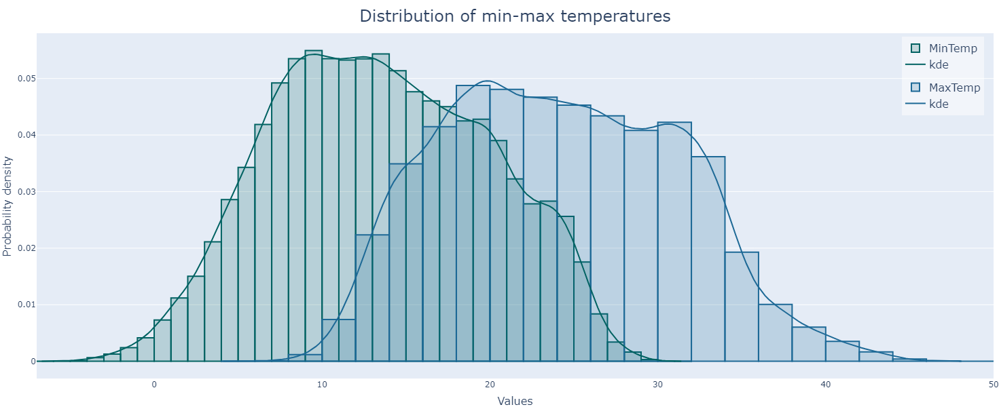

In [4]:
# Let's see how the default aesthetics looks like
atom.plot_distribution(columns=[1, 2], title="Distribution of min-max temperatures")

In [5]:
# Change the color palette using color names or their hex codes
atom.palette = ["red", "#00f"]

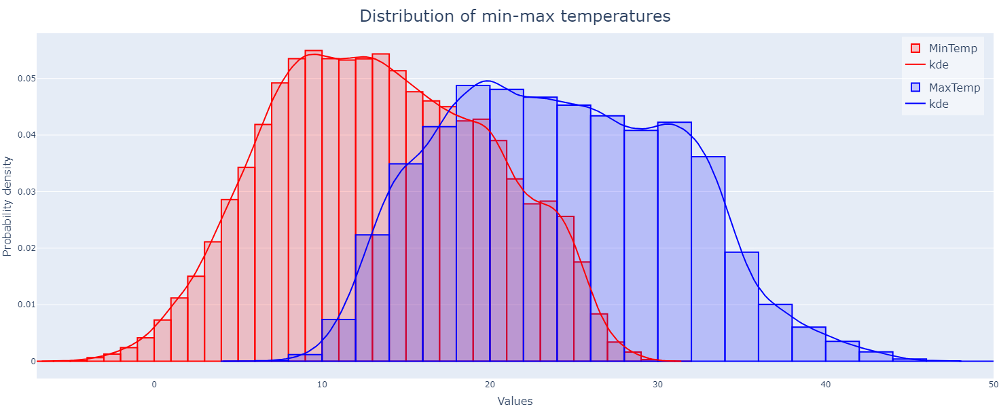

In [6]:
atom.plot_distribution(columns=[1, 2], title="Distribution of min-max temperatures")

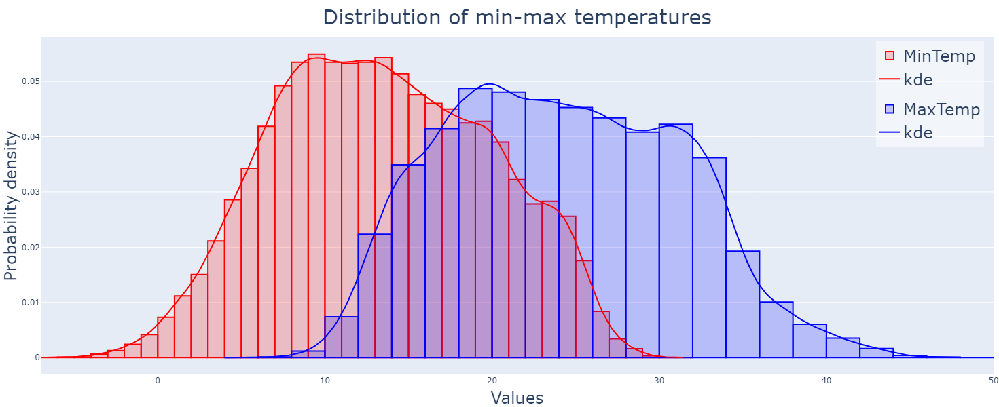

In [7]:
# Change the title and label fontsize
atom.title_fontsize = 30
atom.label_fontsize = 24
atom.plot_distribution(columns=[1, 2], title="Distribution of min-max temperatures")

## Customize the plot's layout

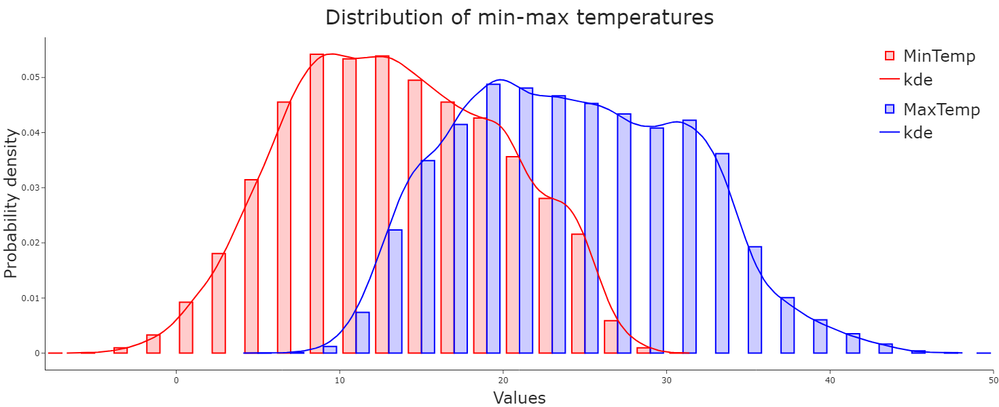

In [8]:
# Use the update_layout method to change layout properties
atom.update_layout(template="simple_white", barmode="group", hovermode="x")
atom.plot_distribution(columns=[1, 2], title="Distribution of min-max temperatures")

## Customize the title and legend

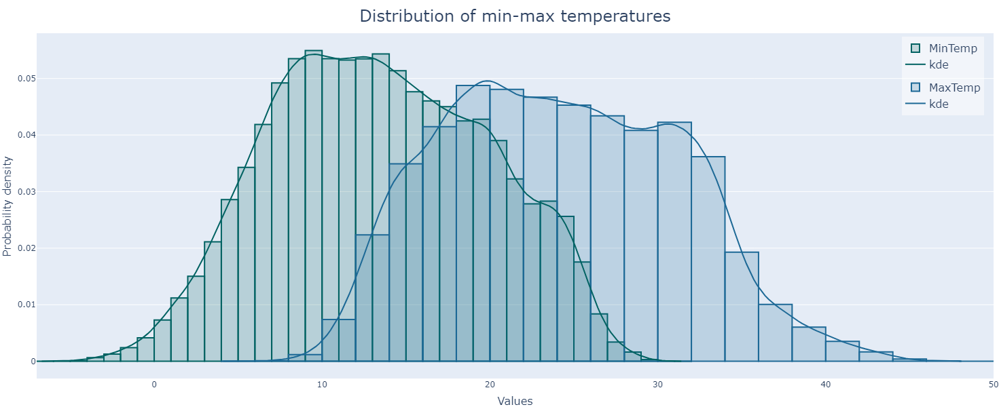

In [9]:
# Let's go back to the default aesthetics
atom.reset_aesthetics()
atom.plot_distribution(columns=[1, 2], title="Distribution of min-max temperatures")

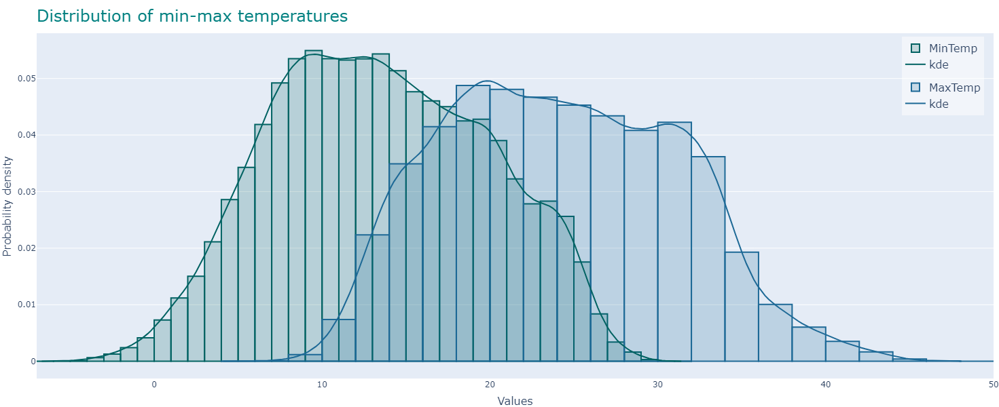

In [10]:
# And update the title with some custom fonts
atom.plot_distribution(columns=[1, 2], title=dict(text="Distribution of min-max temperatures", font_color="teal", x=0, xanchor="left"))

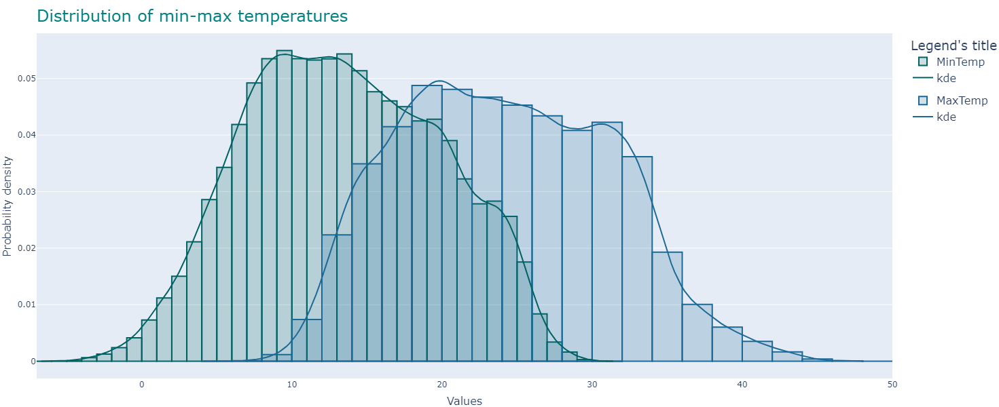

In [11]:
# We can update the legend in a similar fashion
atom.plot_distribution(
    columns=[1, 2],
    title=dict(text="Distribution of min-max temperatures", font_color="teal", x=0, xanchor="left"),
    legend=dict(title="Legend's title"),
)

## Using a canvas

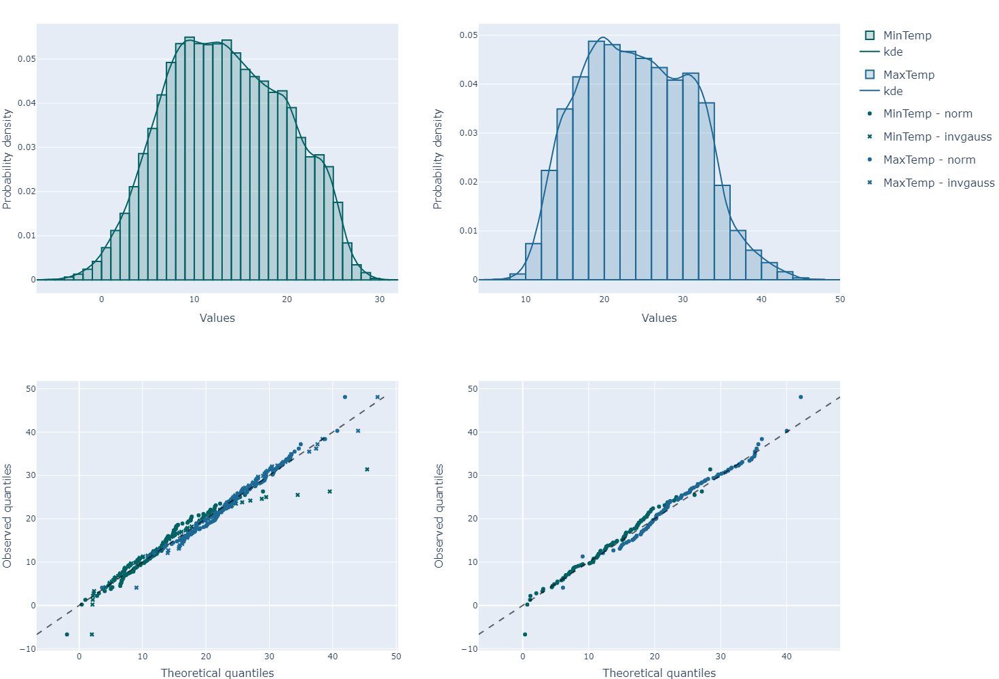

In [21]:
with atom.canvas(2, 2):
    atom.plot_distribution(columns=1)
    atom.plot_distribution(columns=2)
    atom.plot_qq(columns=[1, 2], distributions=["norm", "invgauss"])
    atom.plot_qq(columns=[1, 2])